In [13]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn import datasets

%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
plt.rcParams['figure.figsize'] = 1,1  # default hor./vert. size of plots, in inches
plt.rcParams['lines.markeredgewidth'] = 1  # to fix issue with seaborn box plots; needed after import seaborn

In [14]:
def plot_sample(bounds, data):
    '''Plots a set of sample points
    Used to save the image of the sampling
    '''
    
    x, y = zip(*data)
    plt.scatter(x, y, s=0.5, color='black', alpha=0.8)
    axes = plt.gca()
    axes.set_xlim([0,bounds])
    axes.set_ylim([0,bounds])
    plt.axis('off')

In [15]:
def gen_circle(bounds, max_size, min_size=0):
    '''Generates a circle within the bounds respecting the given max and min size'''
    
    r = min_size + np.random.random() * (max_size - min_size)
    p = r + np.random.rand(2) * (bounds - 2*r)
    return ['circle', p[0], p[1], r]

In [4]:
gen_circle(100, 10)

['circle', 90.10845466341651, 65.35238873417433, 6.223603230653025]

In [16]:
def gen_rect(bounds, max_size, min_size=0):
    '''Generates a rectangle within the bounds respecting the given max and min size'''
    
    dim = min_size + np.random.rand(2) * (max_size - min_size)
    x_min = np.random.rand() * (bounds - dim[0])
    y_min = np.random.rand() * (bounds - dim[1])
    return ['rect', x_min, y_min, dim[0], dim[1]]

In [20]:
gen_rect(100, 10)

['rect',
 39.0988095205457,
 77.35376808961756,
 1.0176942671337763,
 3.2697271413056797]

In [17]:
def gen_line(bounds):
    '''Generates a line within the bounds'''
    
    p = [0, 0, 0, 0]
    eps = (bounds / 2)**2
    while (p[0] - p[2])**2 + (p[1] - p[3])**2 < eps:
        p = np.random.rand(4) * bounds
    return ['line', p[0], p[1], p[2], p[3]]

In [22]:
gen_line(100)

['line',
 54.25288285174147,
 7.06378126481747,
 3.14603368408346,
 70.84055918353387]

In [18]:
def gen_data1(bounds, n):
    '''Generates shape data for experiment 1'''
    
    ret = []
    max_size = bounds / 2
    min_size = bounds / 5
    
    for _ in range(n):
        rand = np.random.rand()
        if rand < 0.33:
            ret.append(gen_circle(bounds, max_size, min_size))
        elif rand < 0.66:
            ret.append(gen_rect(bounds, max_size, min_size))
        else:
            ret.append(gen_line(bounds))
            
    return ret

In [ ]:
def gen_data2(bounds, n):
    '''Generates shape data for experiment 2'''
    
    ret = []
    
    for _ in range(n):
        ret.append(gen_line(bounds))
        
    return ret

In [19]:
def write_shape_data(data, i):
    '''Creates a .shapes file defining the shapes used'''
    
    with open('../data/%i.shapes' % i, 'w') as f:
        for x in data:
            if x[0] == 'circle':
                f.write("{} {} {} {}\n".format(x[0], x[1], x[2], x[3]))
            else:
                f.write("{} {} {} {} {}\n".format(x[0], x[1], x[2], x[3], x[4]))

In [20]:
def sample(data, n, noise):
    '''Samples the given shape (data) with n sampling points
    Given a maximum noise threshold (in both x and y)
    '''
    
    ret = []
    
    # sample n times
    for i in range(n):
        
        # pick a random shape
        k = np.random.randint(0, len(data))
        x = data[k]
        
        # generate some small offset
        xnoise = np.random.rand(2) * noise
        
        # sample differently based on shape
        if x[0] == 'circle':
            theta = np.random.rand() * 2 * np.pi
            p = [x[1] + np.cos(theta) * x[3] + xnoise[0], x[2] + np.sin(theta) * x[3] + xnoise[1]]
        elif x[0] == 'rect':
            t = np.random.rand()
            if t < 0.25:
                t = t * 4
                x0, y0, x1, y1 = x[1], x[2], x[1] + x[3], x[2]
                p = [(1-t) * x0 + t * x1 + xnoise[0], (1-t) * y0 + t * y1 + xnoise[1]]
            elif t < 0.5:
                t = (t - 0.25) * 4
                x0, y0, x1, y1 = x[1] + x[3], x[2], x[1] + x[3], x[2] + x[4]
                p = [(1-t) * x0 + t * x1 + xnoise[0], (1-t) * y0 + t * y1 + xnoise[1]]
            elif t < 0.75:
                t = (t - 0.5) * 4
                x0, y0, x1, y1 = x[1], x[2] + x[4], x[1] + x[3], x[2] + x[4]
                p = [(1-t) * x0 + t * x1 + xnoise[0], (1-t) * y0 + t * y1 + xnoise[1]]
            else:
                t = (t - 0.75) * 4
                x0, y0, x1, y1 = x[1], x[2], x[1], x[2] + x[4]
                p = [(1-t) * x0 + t * x1 + xnoise[0], (1-t) * y0 + t * y1 + xnoise[1]]
        else:
            # shape is a line
            t = np.random.rand()
            p = [(1-t) * x[1] + t * x[3] + xnoise[0], (1-t) * x[2] + t * x[4] + xnoise[1]]
        
        # append sampling point to list
        ret.append(p)
        
    return ret

In [21]:
def write_sample_data(data, i):
    '''Writes sample points to .in file'''
    
    with open('../data/%i.in' % i, 'w') as f:
        for x in data:
            f.write("{} {}\n".format(x[0], x[1]))

In [22]:
def gen_dataset1(bounds, n, max_shapes):
    '''Generates dataset for experiment 1
    Given bounds of rectangle, number of test cases and max number of shapes
    '''
    
    min_sample = 50
    max_sample = 100
    
    # generate n test cases
    for i in range(n):
        # generate shape data
        k = np.random.randint(1, max_shapes + 1)
        data = gen_data(bounds, k)
        write_shape_data(data, i)
        
        # sample shapes
        sample_n = k * np.random.randint(min_sample, max_sample)
        sample_data = sample(data, sample_n, bounds / 50)
        write_sample_data(sample_data, i)
        
        # plot sample
        plot = plot_sample(bounds, sample_data)
        plt.savefig("../data/%i.png" % i, dpi = 64, bbox_inches=None, pad_inches = 0)
        plt.show()
        

In [ ]:
def gen_dataset2(bounds, n, shapes):
    '''Generates dataset for experiment 2
    Given bounds of rectangle, number of test cases and number of shapes
    '''
    
    min_sample = 200
    max_sample = 300
    
    # generate n test cases
    for i in range(n):
        # generate shape data
        k = shapes
        data = gen_data(bounds, k)
        write_shape_data(data, i)
        
        # sample shapes
        sample_n = k * np.random.randint(min_sample, max_sample)
        sample_data = sample(data, sample_n, bounds / 50)
        write_sample_data(sample_data, i)
        
        # plot sample
        plot = plot_sample(bounds, sample_data)
        plt.savefig("../data/%i.png" % i, dpi = 64, bbox_inches=None, pad_inches = 0)
        plt.show()

In [ ]:
# create training set
gen_dataset1(64, 10000, 5)

In [ ]:
# create validation set
gen_dataset1(64, 2000, 5)

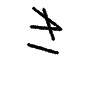

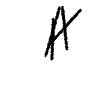

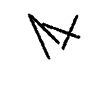

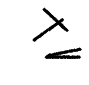

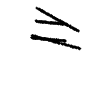

...

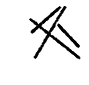

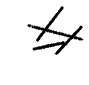

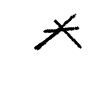

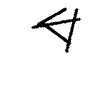

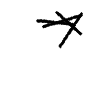

In [24]:
# create training set
gen_dataset2(64, 10000, 4)

In [ ]:
# create validation set
gen_dataset2(64, 2000, 4)